- Before looking at the data try to get some context:
    - ESPN coverage of NFL Call to Action: http://www.espn.com/nfl/story/_/id/24743994/really-changed-nfl-call-action-concussions
    - NFL 2018 Health and Safety Report: https://annualreport.playsmartplaysafe.com/#data-injury-reduction-plan
    - 2018 Kickoff Rule Changes: https://www.si.com/nfl/2018/09/07/nfl-kickoff-rule-changes-explained-onside-return-clarified
    - Chronology of Kickoff rule changes: http://www.footballzebras.com/2018/05/chronology-of-kickoff-rules-changes/
    - Relevant Concussion paper: https://journals.sagepub.com/doi/full/10.1177/0363546518804498

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

#### <a id='return_yardage'>Plot of Return Yardage</a>
[Jump to NGS Analysis](#ngs_analysis)

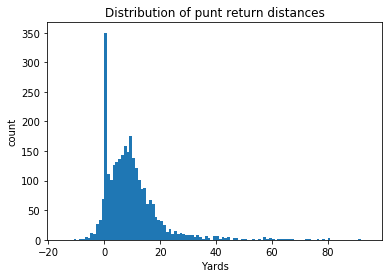

count    2799.000000
mean        9.038585
std        10.209210
min       -11.000000
25%         2.000000
50%         7.000000
75%        12.000000
max        91.000000
Name: yardage on play, dtype: float64


In [245]:
'''PLOT of distribution of punt return distances'''
bins = [i for i in range(-15, 95, 1)]
plt.hist(remainder_df['yardage on play'], bins=bins)

plt.title('Distribution of punt return distances')
plt.xlabel('Yards')
plt.ylabel('count')
plt.show()

print(remainder_df['yardage on play'].describe())

### PLAYER PUNT DATA
- Player Punt Data: Player level data that specifies the traditional football position for each player. Each player is identified using his GSISID.
- <b>GSISID</b>: unique id for each player
- Note that some players are shown to have multiple jersey numbers associated with them

In [2]:
player_df = pd.read_csv('data/player_punt_data.csv')
print(player_df.shape)
player_df[player_df['GSISID'] == 28121]

(3259, 3)


,GSISID,Number,Position
186,28121,22,RB
452,28121,31w,RB
1114,28121,28,RB
1353,28121,6,RB
2051,28121,31o,RB


### PLAY PLAYER ROLE DATA
- Play Player Role Data: Play and player level data that specifies a punt specific player role. This dataset will specify each player that played in each play. A player’s role in a play is uniquely defined by the Gamekey PlayID and GSISID.
- Roles are described in appendix of Data Manual

In [3]:
play_player_role_df = pd.read_csv('data/play_player_role_data.csv')
print(play_player_role_df.shape)
play_player_role_df.tail(2)

(146573, 5)


,Season_Year,GameKey,PlayID,GSISID,Role
146571,2017,414,3425,33704,PRG
146572,2017,414,2210,33704,PRG


### MASTER PLAYER DATASET

In [4]:
# Relevant Player Information, Position, Role, Number
what_player_df = pd.merge(player_df, play_player_role_df,
                          how='inner',
                          on=['GSISID'])
what_player_df.head()

,GSISID,Number,Position,Season_Year,GameKey,PlayID,Role
0,32069,36,SS,2016,23,2255,PPL
1,32069,36,SS,2016,23,884,PRW
2,32069,36,SS,2016,23,1157,PRW
3,32069,36,SS,2016,23,848,PRW
4,32069,36,SS,2016,23,3065,PPL


### Video Footage

In [8]:
'''Control Video Footage'''
video_footage_control_df = pd.read_csv('data/video_footage-control.csv')
print(video_footage_control_df.shape)
video_footage_control_df.tail(1)

(37, 10)


,season,Season_Type,Week,Home_team,Visit_Team,Qtr,PlayDescription,gamekey,playid,Preview Link
36,2017,Reg,2,New Orleans Saints,New England Patriots,3,"(7:42) R.Allen punts 27 yards to NO 29, Center...",421,2870,http://a.video.nfl.com//films/vodzilla/153628/...


In [7]:
# Get Players Who are Injured
injured_players = pd.merge(injury_play, what_player_df,
                           how='inner',
                           on=['GSISID', 'GameKey', 'PlayID', 'Season_Year'])

print('Shape:', injured_players.shape)
injured_players.head(4)

NameError: name 'injury_play' is not defined

# NEXT GEN STATS (NGS)
- Next Gen Stats – player level data that describes the movement of each player during a play. NGS data is processed by BIOCORE to produce relevant speed and direction data. The NGS data is identified using GameKey, PlayID, and GSISID. Player data for each play is provided as a function of time (Time) for the duration of the play.
- Players are recorded at every <b>millisecond</b>
- Field dimensions: 120 yards by 53.3 yards
- Speed can be calculated with Time and dis
- <b>Event</b> record pretty regular events

- May want to come back to speed and angles data to determine severity of impacts, but that will likely not be helpful for devising new rules regarding those metrics
## COMBINE NGS DATA FOR CONCUSSION EVENTS AND ALL PLAYS 
## (ONLY NEED TO RUN ONCE)

In [5]:
# Read in only concussion data
ngs_concussion = pd.read_csv('data/NGS-concussion.csv')

In [6]:
# From way earlier (VIDEO FOOTAGE SECTION)
concussion_and_partner.head()

NameError: name 'concussion_and_partner' is not defined

In [ ]:
# Map Routes of concussed player and partner player
for i in range(len(concussion_and_partner)):
    # Get necessary values for query of NGS data
    game = concussion_and_partner.loc[i, 'GameKey']
    current_play = concussion_and_partner.loc[i, 'PlayID']
    concussed_id = concussion_and_partner.loc[i, 'GSISID']
    partner_id = concussion_and_partner.loc[i, 'Primary_Partner_GSISID']
    print(game)

    # Concussed player
    where_condition = (ngs_concussion['GSISID'] == concussed_id) &\
        (ngs_concussion['PlayID'] == current_play) &\
        (ngs_concussion['GameKey'] == game)
    concussion = ngs_concussion[where_condition].copy()
    # Reorder by Time and reset index
    concussion.sort_values(by=['Time'], inplace=True)
    concussion.reset_index(drop=True, inplace=True)
    
    # Partner player
    where_condition = (ngs_concussion['GSISID'] == partner_id) &\
        (ngs_concussion['PlayID'] == current_play) &\
        (ngs_concussion['GameKey'] == game)
    partner = ngs_concussion[where_condition].copy()
    partner.sort_values(by=['Time'], inplace=True)
    partner.reset_index(drop=True, inplace=True)

    # Variables for Mapping
    concussion_x = concussion['x']
    concussion_y = concussion['y']
    partner_x = partner['x']
    partner_y = partner['y']
    speed1 = concussion['dis'] / 0.1
    speed2 = partner['dis'] / 0.1
    time = [i * 0.1 for i in range(len(speed1))]
    
    # Mapping of play
    sns.set()
    plt.figure(figsize=(10,5))
    plt.scatter(concussion_x, concussion_y, c=speed1, alpha=0.5)
    plt.scatter(partner_x, partner_y, c=speed2, alpha=0.5)
    plt.colorbar(label='yards/sec')
    plt.xlim(0, 120)
    plt.ylim(0, 53.3)
    plt.title('Playing Field')
    plt.xlabel('yardline')
    plt.ylabel('width of field')
    plt.show()

- Note: fastest times for 40 yard dash range from 4.22 - 4.30 seconds, which is equivalent to 9.30 - 9.48 yards/sec
- Some of the player speeds seem very inaccurate (high and low extremes) datawise
    - gameID: 218, 289, 296, 414, 506, 553, 567, 585
    - 218 is slow player
    - 289 unsure as can't see players during highest speed part
    - 296 players might be just wicked fast
    - 414 looks entirely inaccurate speed analysis
    - 506 data is almost accurate, player isn't moving a ton on the play
    - 553 speed is inaccurate, position on field is inaccurate
    - 567 possibility a shove in the back when going after ball; speed at impact looks correct
    - 585 speed is entirely inaccurate
    

# <a id='ngs_analysis'>Analyze NGS play data</a>

[Plot Return Yardage](#return_yardage)

- We'll be taking our condensed set of games and natural joining with the NGS data for each year and then recombining data so we have a dataset of 'cleanish' punt returns. We'll use this data to get conditional statistics on returns given distance of closest punt player to punt receiver. We'll use the assumption that the furthest player from the punt at the 'event': 'punt_returned' is the one who actually is receiving the ball.
- Consider events, speed, and player proximities

In [164]:
# Load in all NGS data
play_df = pd.read_csv('data/play_information.csv')
play_player_role_df = pd.read_csv('data/play_player_role_data.csv')
ngs_2016 = pd.read_csv('data/NGS-2016.csv')
ngs_2017 = pd.read_csv('data/NGS-2017.csv')

In [246]:
# Don't forget about our condensed set of plays
print(remainder_df.shape)
remainder_df.head()

# # Use when you want to see the unique combos of gamekey,playid in a dataset
# df.groupby(['GameKey','PlayID']).size().reset_index().rename(columns={0:'count'})

(2799, 4)


,GameKey,PlayID,PlayDescription,yardage on play
0,2,1227,"(10:01) C.Jones punts 40 yards to LA 42, Cente...",25
1,3,455,(6:44) (Punt formation) S.Koch punts 54 yards ...,9
2,3,1542,(2:54) (Punt formation) S.Koch punts 45 yards ...,-1
3,4,927,"(1:53) A.Lee punts 40 yards to GB 27, Center-C...",1
4,4,1725,"(2:48) A.Lee punts 66 yards to GB 15, Center-C...",5


In [168]:
# Create condensed set of NGS data for the normal return plays
condensed_ngs_2016 = pd.merge(remainder_df, ngs_2016,
                          how='inner',
                          on=['GameKey', 'PlayID'])
condensed_ngs_2017 = pd.merge(remainder_df, ngs_2017,
                          how='inner',
                          on=['GameKey', 'PlayID'])

condensed_ngs = pd.concat([condensed_ngs_2016, condensed_ngs_2017], axis=0)

# Memory Management
del condensed_ngs_2016
del condensed_ngs_2017
del ngs_2016
del ngs_2017

(30164386, 12)


,GameKey,PlayID,PlayDescription,Season_Year,GSISID,Time,x,y,dis,o,dir,Event
15821747,664,1046,"(12:07) R.Quigley punts 47 yards to PHI 20, Ce...",2017,30561.0,2018-01-22 00:32:23.900,45.919998,1.07,0.18,245.309998,329.269989,NaN
15821748,664,1046,"(12:07) R.Quigley punts 47 yards to PHI 20, Ce...",2017,27986.0,2018-01-22 00:32:23.900,43.099998,-0.44,0.11,224.410004,323.450012,NaN
15821749,664,1046,"(12:07) R.Quigley punts 47 yards to PHI 20, Ce...",2017,29418.0,2018-01-22 00:32:23.900,51.369999,0.57,0.12,34.599998,126.019997,NaN
15821750,664,1046,"(12:07) R.Quigley punts 47 yards to PHI 20, Ce...",2017,30465.0,2018-01-22 00:32:23.900,42.869999,0.78,0.11,356.529999,75.120003,NaN
15821751,664,1046,"(12:07) R.Quigley punts 47 yards to PHI 20, Ce...",2017,28536.0,2018-01-22 00:32:23.900,54.250000,14.02,0.18,82.019997,168.139999,NaN


In [169]:
'''ONLY RUN IF YOU DON'T HAVE THE DATA'''
condensed_ngs.to_csv('data/condensed-NGS.csv', index=False)

In [179]:
# punt_count_2016 = len(ngs_2016.groupby(['GameKey','PlayID']).size().reset_index().rename(columns={0:'count'}))
# punt_count_2017 = len(ngs_2017.groupby(['GameKey','PlayID']).size().reset_index().rename(columns={0:'count'}))
# print('NGS Data indicates there are', str(punt_count_2016 + punt_count_2017), 'punts over the two seasons')

- NGS data exists for 6666 punts out of 6681 punts accounted for the 'play information' dataset

In [180]:
# How many unique plays in play_player_role dataset?
print('# of unique plays according to play_player_role dataset:',
      len(play_player_role_df.groupby(['GameKey','PlayID']).size().reset_index().rename(columns={0:'count'})))

# How many roles are there?
print('# of roles in dataset:', len(play_player_role_df['Role'].value_counts()))

# Let's indicate what team the player is playing on based off player role
return_team_positions = ['PR', 'PDL1', 'PDL2', 'PDL3', 'PDL4', 'PDR1', 'PDR2', 'PDR3', 'PDR4', 'VL', 'VR', 
                         'PLL', 'PLR', 'VRo', 'VRi', 'VLi', 'VLo', 'PLM', 'PLR1', 'PLR2', 'PLL1', 'PLL2',
                         'PFB', 'PDL5', 'PDR5', 'PDL6', 'PLR3', 'PLL3', 'PDR6', 'PLM1', 'PDM']
punt_team_positions = ['P', 'PLS', 'PPR', 'PLG', 'PRG', 'PLT', 'PRT', 'PLW', 'PRW', 'GL', 'GR',
                       'GRo', 'GRi', 'GLi', 'GLo', 'PC', 'PPRo', 'PPRi', 'PPL', 'PPLi', 'PPLo']

# We need a list of (GameKey, PlayID) keys to properly iterate through NGS dataset in chunks
gamekey_playid_pair = play_player_role_df.groupby(['GameKey','PlayID']).size().reset_index().drop(columns=0)

# Add binary classification column for if play had a 'punt_received'
# Used to reduce processing in future analysis
gamekey_playid_pair['punt_received'] = 0

# of unique plays according to play_player_role dataset: 6670
# of roles in dataset: 52


In [193]:
print('Number of plays with punt_received as an event:',
      punt_received_df.groupby(['GameKey','PlayID']).size().reset_index().drop(columns=0).shape[0],
     'vs 2799 from the remainder dataframe')

Number of plays with punt_received as an event: 2628 vs 2799 from the remainder dataframe


In [250]:
def event_df_creation(df, event):
    '''Get a new dataframe with just data pertinent to a particular event'''
    new_df = df[df['Event'] == event].reset_index()
    unique_ids = new_df.groupby(['GameKey','PlayID']).size().reset_index().rename(columns={0:'count'})
    return new_df, unique_ids

In [251]:
punt_received_df, unique_ids = event_df_creation(condensed_ngs, 'punt_received')
punt_received_df.head()

,index,GameKey,PlayID,PlayDescription,Season_Year,GSISID,Time,x,y,dis,o,dir,Event
0,6130,3,455,(6:44) (Punt formation) S.Koch punts 54 yards ...,2016,31338.0,2016-08-11 23:51:08.400,64.199997,9.53,0.91,8.750000,101.239998,punt_received
1,6131,3,455,(6:44) (Punt formation) S.Koch punts 54 yards ...,2016,27831.0,2016-08-11 23:51:08.400,74.019997,14.00,0.94,19.990000,114.550003,punt_received
2,6132,3,455,(6:44) (Punt formation) S.Koch punts 54 yards ...,2016,30463.0,2016-08-11 23:51:08.400,54.290001,9.73,0.80,18.959999,111.660004,punt_received
3,6133,3,455,(6:44) (Punt formation) S.Koch punts 54 yards ...,2016,31868.0,2016-08-11 23:51:08.400,95.930000,3.86,0.13,204.639999,130.490005,punt_received
4,6134,3,455,(6:44) (Punt formation) S.Koch punts 54 yards ...,2016,32973.0,2016-08-11 23:51:08.400,87.430000,3.85,0.98,341.149994,85.639999,punt_received


In [255]:
def plot_punt_received(df, unique_ids):
    '''
    Function to either plot out plays where a given event has occured and to label remainder_df
    df: NGS dataframe that has already been filtered by some event
    unique_ids: unique (gamekey,playID) pairs built from NGS dataframe of an eve t
    '''
    # Iterate through unique (GameKey, PlayID)
    for i in range(len(unique_ids)):

        # Game information
        game_key = unique_ids.loc[i, 'GameKey']
        play_id = unique_ids.loc[i, 'PlayID']

        # Get one unique set of data points related to a single (GameKey, PlayID) pair
        where_condition = ((df['GameKey'] == game_key) &\
                           (df['PlayID'] == play_id))
        just_view = df[where_condition].reset_index()
        
        # Prepare figure of players positions when punt is received
        fig, ax = plt.subplots()
        sns.set()
        for j in range(len(just_view)):
            # Player information
            player = just_view.loc[i, 'GSISID']
            position_x = just_view.loc[j, 'x']
            position_y = just_view.loc[j, 'y']
            where_condition = ((play_player_role_df['GameKey'] == game_key) &\
                               (play_player_role_df['PlayID'] == play_id) &\
                               (play_player_role_df['GSISID'] == player))
            
            # For handling errors where a GSISID in NGS data is not in play_player_role data
            try:
                role = play_player_role_df[where_condition].reset_index().loc[0, 'Role']
            except KeyError:
                continue

            # Label based on offense or defense and map player position
            if role in return_team_positions:
                side = 'return team'
                ax.scatter(position_x, position_y, alpha=0.8, color='red')
            else:
                side = 'punt team'
                ax.scatter(position_x, position_y, alpha=0.8, color='blue')

        plt.xlim(0, 120)
        plt.ylim(0, 53.3)
        ax.set_xticklabels(['Edge', '10', '30', '50', '30', '10', 'Edge'])
        plt.title('Playing Field')
        plt.xlabel('yardline')
        plt.ylabel('width of field')
        red_patch = mpatches.Patch(color='red', label='return team')
        blue_patch = mpatches.Patch(color='blue', label='punt team')
        plt.legend(handles=[red_patch, blue_patch])
        plt.show()

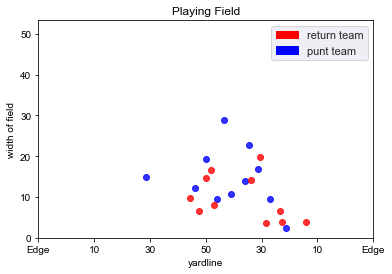

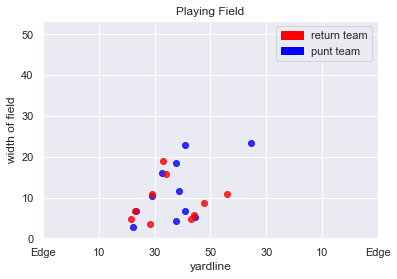

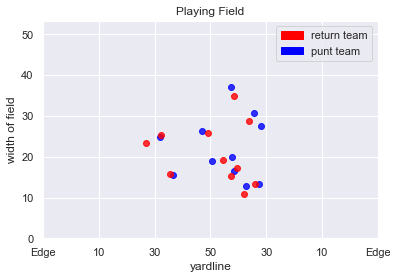

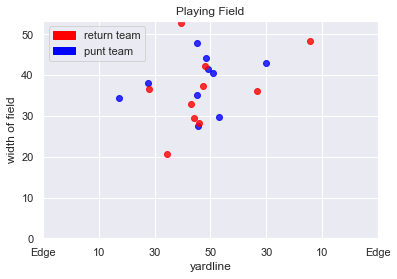

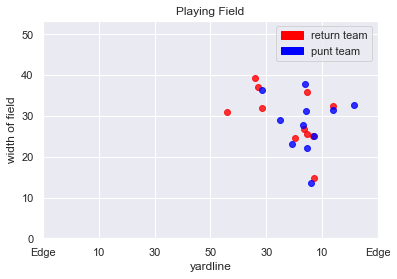

...

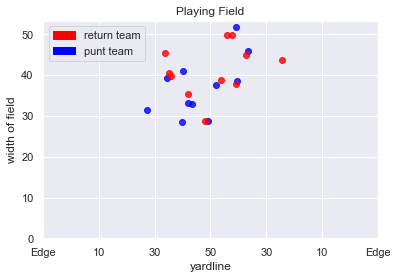

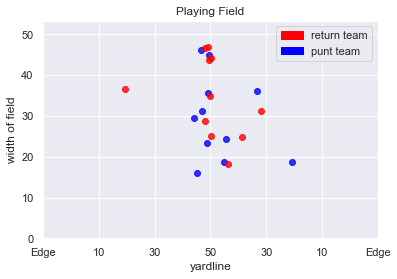

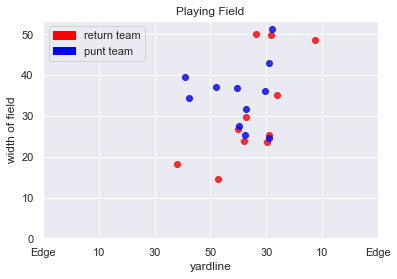

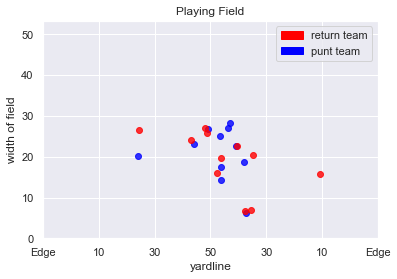

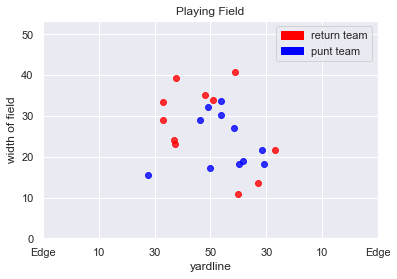

KeyboardInterrupt: 

In [256]:
# Plot all positions at the time of specific event
plot_punt_received(punt_received_df, unique_ids)

In [282]:
'''
Procedure:
- Find the min and max x position for punt team and return team
- Assumption is whichever value for return team is not inclusive of range between min-max
of punt team, that is where the punter is currently. Thus choose the opposite extreme for
proximity calculation to whoever just received the punt
- Example: return_min = 10.0, return_max = 50.0, punt_min=20.0, punt_max=60.0
    - punt_min must be the closest player to whoever is receiving ball because punt_max is not within
    range of (return_min, return_max)
    - Thus closest punt team player to ball is abs(punt_min - return_min) = 10.0
'''
def calculate_player_proximity(just_view):
    # Split up teams
    punt_team_df = just_view[just_view['team'] == 'punt team'].reset_index(drop=True)
    return_team_df = just_view[just_view['team'] == 'return team'].reset_index(drop=True)

    # Get min and max values for each team
    punt_min = min(punt_team_df['x'])
    punt_max = max(punt_team_df['x'])
    return_min = min(return_team_df['x'])
    return_max = max(return_team_df['x'])

    # Find position of ball carrier and nearest punt team player
    if punt_min <= return_min:
        # Ball is on other extreme
        return abs(return_max - punt_max)
    else:
        # Ball is on this extreme
        return abs(return_min - punt_min)

In [301]:
# We need to calculate distance of nearest opponent to punt receiver
unique_ids['proximity'] = 0

# Iterate through unique (GameKey, PlayID)
for i in range(len(unique_ids)):

    # Game information
    game_key = unique_ids.loc[i, 'GameKey']
    play_id = unique_ids.loc[i, 'PlayID']

    # Get one unique set of data points related to a single (GameKey, PlayID) pair
    where_condition = ((punt_received_df['GameKey'] == game_key) &\
                       (punt_received_df['PlayID'] == play_id))
    just_view = punt_received_df[where_condition].reset_index()
    just_view['team'] = ''

    for j in range(len(just_view)):
            # Player information
            player = just_view.loc[j, 'GSISID']
            position_x = just_view.loc[j, 'x']
            position_y = just_view.loc[j, 'y']
            where_condition = ((play_player_role_df['GameKey'] == game_key) &\
                               (play_player_role_df['PlayID'] == play_id) &\
                               (play_player_role_df['GSISID'] == player))

            # For handling errors where a GSISID in NGS data is not in play_player_role data
            try:
                role = play_player_role_df[where_condition].reset_index().loc[0, 'Role']
            except KeyError:
                continue

            # Label based on offense or defense and map player position
            if role in return_team_positions:
                just_view.loc[j, 'team'] = 'return team'
            else:
                just_view.loc[j, 'team'] = 'punt team'
    
    # Calculate proximity
    proximity = calculate_player_proximity(just_view)
    unique_ids.loc[i, 'proximity'] = proximity

7.120002746582031
0.7300014495849609
4.889999389648445
15.660003662109375
12.639999389648438
3.1700057983398438
6.760000228881832
20.67000579833983
11.579998016357422
6.220001220703125
5.86000061035157
5.099998474121122
16.419998168945312
3.7900009155273295
22.70000076293945
27.729999542236317
4.459999084472656
14.039997100830078
14.980003356933622
7.050003051757827
10.359996795654297
3.509998321533203
8.52999877929689
12.139999389648438
23.789999008178704
3.6399993896484517
2.6900005340576207
10.829999923706055
21.58999633789064
6.339998245239247
1.529998779296875
14.439998626708977
2.7800025939941406
17.26999855041505
9.129997253417976
5.379999160766598
0.5
9.930000305175781
8.21999740600586
8.110000610351577
11.149999618530277
8.10000228881836
7.8300018310546875
8.270000457763672
26.10000038146973
6.520000457763672
17.51000213623047
10.599998474121108
15.930000305175781
8.279998779296871
0.2800025939941335
5.029998779296882
4.75
3.840000152587887
4.020000457763665
7.550003051757798


9.44000244140625
12.20999908447266
9.080001831054695
11.479999542236335
7.020004272460952
1.660003662109375
6.710002899169915
1.1599998474121165
7.810001373291023
6.3600006103515625
2.470001220703111
1.6899986267089844
10.0
3.3000030517578196
5.439998626708984
0.6399993896484304
9.779998779296875
6.8899993896484375
5.75
17.989997863769535
18.050003051757805
6.690002441406243
15.950004577636719
8.479999542236321
13.099998474121087
8.559999465942383
15.069999694824222
12.270000457763672
6.0500030517578125
5.4799995422363175
2.1199989318847656
10.370002746582031
7.950000762939446
13.509994506835923
5.729999542236328
11.979999542236335
1.3499984741210866
6.430000305175788
6.749999999999986
0.3199996948242081
19.239997863769535
7.370002746582031
2.389999389648434
8.089996337890597
4.2600002288818395
5.029998779296875
13.150001525878892
3.329998016357429
3.0999984741210795
13.450000762939442
19.8100004196167
7.3900070190429545
11.34999847412108
10.810005187988267
1.0799999237060511
12.859998

7.510000228881836
8.289997100830078
12.60000610351561
12.25
3.8800010681152344
8.629997253417969
5.2900009155273295
7.090003967285156
4.960006713867173
13.850000381469727
9.809999465942386
14.880001068115229
3.289999008178711
4.829998016357422
0.44000244140625
0.10999870300292969
9.580001831054688
19.40999984741211
9.449996948242173
2.520000457763679
10.650001525878906
3.4599952697753764
7.130001068115234
3.799999237060547
6.769996643066378
21.330001831054666
20.919998168945312
3.4800033569335938
10.259998321533203
7.020000457763672
4.099998474121108
6.430000305175781
1.550003051757841
8.880001068115224
11.59000396728517
14.700004577636733
21.189994812011705
21.54000091552733
10.630004882812486
10.099998474121108
0.2400054931640625
4.5
12.440002441406264
7.340003967285156
17.010000228881847
6.229999542236335
10.490005493164077
7.319999694824219
3.2399978637695312
5.300003051757827
11.369998931884766
5.479995727539077
4.090000152587891
9.580001831054688
6.489997863769531
6.2700004577636

18.599998474121094
10.569999694824226
13.100002288818366
1.959999084472642
14.760002136230469
14.629997253417969
2.0
18.5
7.7699985504150355
6.089996337890611
5.540000915527344
14.829994201660156
12.029998779296903
11.950000762939453
9.849998474121108
11.559997558593736
10.439998626708984
3.75
7.000000000000014
1.0499992370605504
3.639999389648427
11.020000457763672
8.639999389648466
7.0800018310546875
9.579994201660156
6.799999237060547
3.5299987792968714
12.110000610351562
5.220001220703111
1.2999992370605469
21.72000122070311
8.649997711181634
12.959999084472656
20.920001983642585
11.220001220703125
14.119998931884766
7.450000762939446
5.790000915527337
4.159997940063477
7.050003051757805
2.9400005340576154
9.220001220703125
3.3300018310546875
8.799995422363267
9.300003051757798
10.95000076293946
2.1299972534179688
7.9499969482421875
9.97000122070311
9.899997711181634
15.300000190734865
10.290000915527347
12.950004577636719
4.040000915527344
19.229995727539062
5.810005187988281
27.3

10.620002746582031
6.209999084472656
8.020002365112305
2.5800018310546875
12.34000015258789
0.4099998474121094
5.170001983642571
7.920001983642578
14.680000305175774
11.95000076293946
13.330001831054702
11.799995422363281
6.219997406005852
9.470001220703118
4.620002746582031
5.409999847412109
13.190000534057614
8.360000610351566
11.259998321533203
9.189994812011733
19.07999801635743
16.730003356933594
7.360000610351555
10.579999923706051
5.739997863769531
7.930000305175781
8.970001220703125
6.040000915527358
7.990001678466797
8.709999084472656
16.52000427246095
12.889999389648438
1.8499984741210938
10.050003051757812
2.1399993896484375
15.710000991821289
16.830001831054688
7.029998779296875
8.840003967285156
4.010002136230469
18.029998779296882
11.529998779296875
9.949996948242188
11.959999084472656
0.26000213623048296
3.530000686645508
0.5299987792968892
16.06000137329101
7.770004272460923
4.3000030517578125
6.880001068115234
13.929998397827166
2.8800010681152415
8.05999946594238
3.31

6.980003356933594
10.899993896484375
14.5
6.879999160766602
5.319999694824233
3.490001678466797
4.189998626708984
6.1399993896484375
8.819999694824219
7.709999084472667
1.9400024414062642
13.840002059936523
9.110000610351555
11.269996643066406
14.659996032714858
6.3200035095214915
13.9000015258789
9.310001373291016
7.120000839233402
6.260000228881836
17.44000244140625
7.319999694824212
7.889999389648445
4.549995422363281
11.550003051757827
5.430000305175753
7.620002746582024
6.7900009155273295
9.109996795654304
3.8299999237060653
8.60000610351564
1.8500061035156392
9.270000457763665
7.310001373291016
10.020000457763679
0.4099998474121236
9.61999893188477
8.069999694824219
7.10999870300293
6.009998321533196
9.449996948242188
5.200000762939453
14.079999923706044
20.949996948242216
5.420000076293956
20.51999855041504
7.510002136230469
7.029998779296861
13.61999893188477
13.049999237060554
7.19999694824218
21.96000289916993
3.020000457763672
10.210000991821286
5.6100006103515625
7.36000061

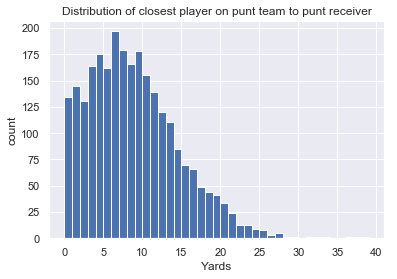

count    2628.000000
mean        8.898360
std         5.756976
min         0.000000
25%         4.520000
50%         8.169998
75%        12.302502
max        38.829998
Name: proximity, dtype: float64

In [302]:
'''PLOT of distribution of punt return distances'''
bins = [i for i in range(0, 40, 1)]
plt.hist(unique_ids['proximity'], bins=bins)

plt.title('Distribution of closest player on punt team to punt receiver')
plt.xlabel('Yards')
plt.ylabel('count')
plt.show()

unique_ids['proximity'].describe()

In [306]:
def build_that_histogram(x, title):
    bins = [i for i in range(min(x), max(x), 1)]
    plt.hist(x, bins=bins)

    plt.title(title)
    plt.xlabel('Yards')
    plt.ylabel('count')
    plt.show()

In [303]:
yard_and_proximity = pd.merge(unique_ids, remainder_df,
                          how='inner',
                          on=['GameKey', 'PlayID'])
print(yard_and_proximity.shape)
yard_and_proximity.head()

(2628, 6)


,GameKey,PlayID,count,proximity,PlayDescription,yardage on play
0,3,455,22,7.120003,(6:44) (Punt formation) S.Koch punts 54 yards ...,9
1,3,1542,21,0.730001,(2:54) (Punt formation) S.Koch punts 45 yards ...,-1
2,4,927,22,4.889999,"(1:53) A.Lee punts 40 yards to GB 27, Center-C...",1
3,4,1725,21,15.660004,"(2:48) A.Lee punts 66 yards to GB 15, Center-C...",5
4,4,2888,22,12.639999,"(3:29) T.Masthay punts 43 yards to GB 44, Cent...",24


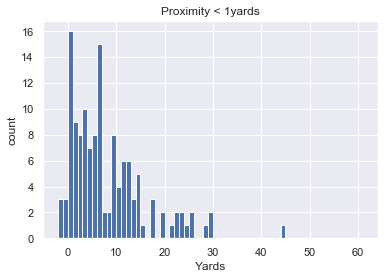

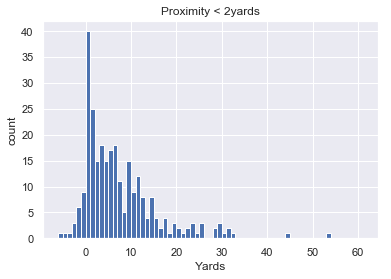

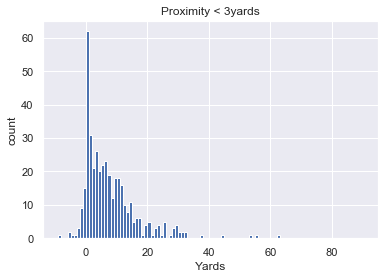

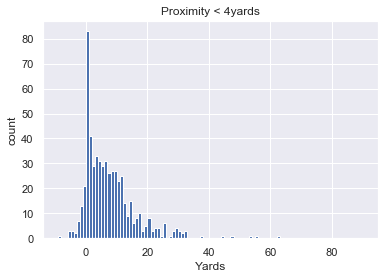

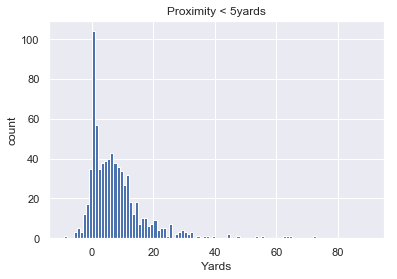

...

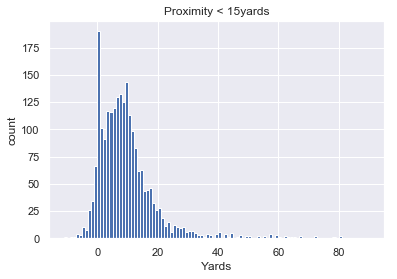

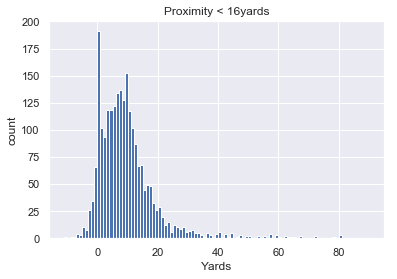

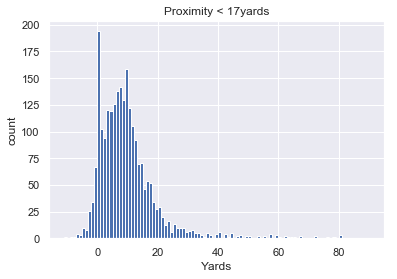

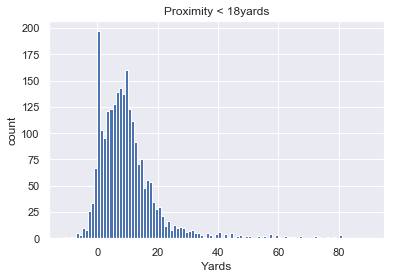

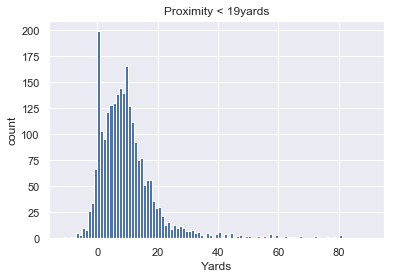

In [309]:
for i in range(1, 20):
    where_condition = yard_and_proximity['proximity'] < i
    title = 'Proximity < ' + str(i) + ' yards'
    x = yard_and_proximity[where_condition]['yardage on play']
    build_that_histogram(x, title)

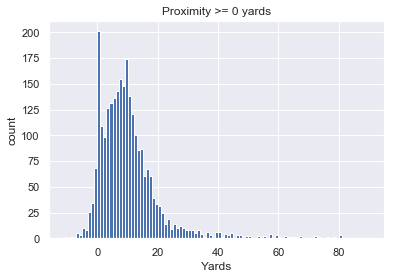

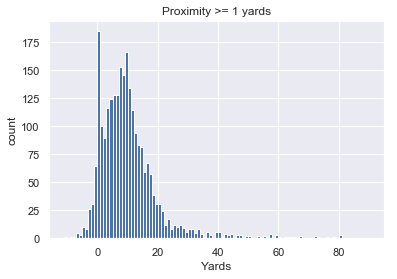

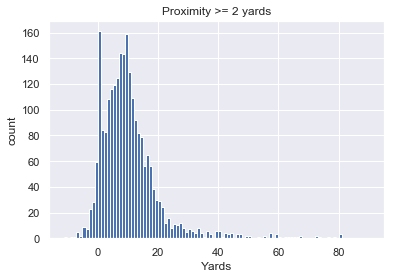

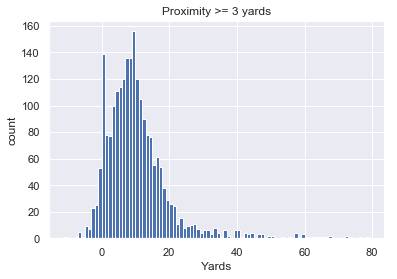

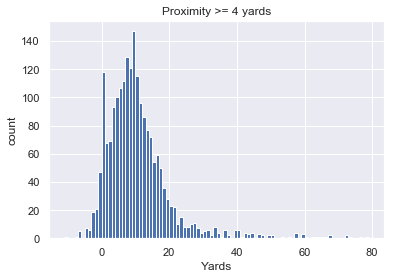

...

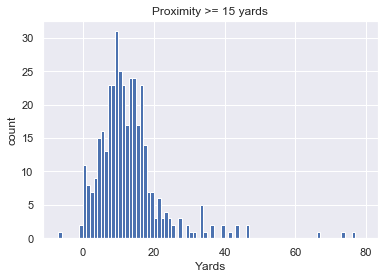

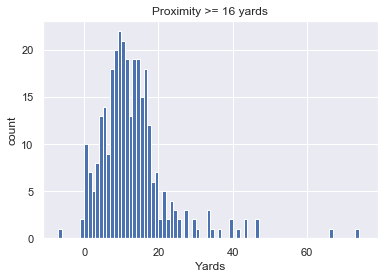

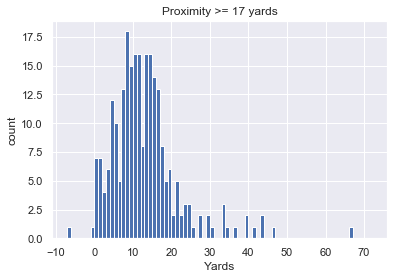

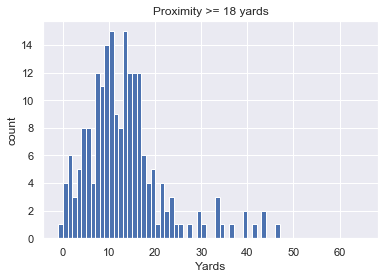

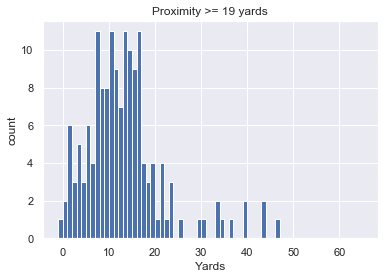

In [313]:
for i in range(0, 20):
    where_condition = yard_and_proximity['proximity'] >= i
    title = 'Proximity >= ' + str(i) + ' yards'
    x = yard_and_proximity[where_condition]['yardage on play']
    build_that_histogram(x, title)

### APPENDIX: OLD CODE

In [ ]:
def find_that_play_word(keyword):
    """Help to find keywords"""
    count = 0
    for i, description in enumerate(condensed_play_df['PlayDescription']):
        condensed_play_df[keyword] = 0
        game_key = condensed_play_df.loc[i, 'GameKey']
        play_id = condensed_play_df.loc[i, 'PlayID']
        parsed_string = description.split()
        for element in parsed_string:
            if element.lower() == keyword:
                print('Keyword', keyword, 'found for (game, play):', '(' + str(game_key) + ',' + str(play_id) + ')')
                print('Play description:', description)
                print('---')
                
                # One-hot encode with keyword
                condensed_play_df[keyword] = 1
                count += 1
                break

    print('# of', keyword, 'occuring on a punt play:', count)

In [ ]:
"""WAS USED INITIALLY TO SEE DISTRIBUTION OF KEY WORDS"""
# # Get counts of words from descriptions to get counts
# all_them_words = {}

# for description in play_df['PlayDescription']:
#     # Create "SET" of elements that are lower case
#     parsed_string = description.split()
#     parsed_string = set([element.lower() for element in parsed_string])
#     for element in parsed_string:
#         try:
#             all_them_words[element] += 1
#         except KeyError:
#             all_them_words[element] = 1

In [ ]:
# # Checkout keywords of interest
# keywords = ['touchback.', 'downed', 'out', 'fair', 'muffs', 'blocked', 'touchdown', 'touchdown',
#             'nullified', 'fumbles', 'safety', 'penalty', 'fake', 'pass', 'middle', 'dead']

# for keyword in keywords:
#     print('Number of occurrences of', keyword, ':', str(all_them_words[keyword]))

In [ ]:
# # Used for later processing of play data
# no_need_playID = []
# no_need_gameID = []

# # Keywords used to flag punts that were deemed 'uneventful'
# keywords = ['out', 'touchback.', 'downed', 'fair']

# for keyword in keywords:
#     count = 0
#     for i, description in enumerate(play_df['PlayDescription']):
#         parsed_string = description.split()
#         for element in parsed_string:
#             if element.lower() == keyword:
#                 print('Keyword', keyword, 'found for play', play_df.loc[i, 'PlayID'], 'and game', play_df.loc[i, 'GameKey'])
#                 print('Play description', description)
#                 print('---')
#                 no_need_playID.append(play_df.loc[i, 'PlayID'])
#                 no_need_gameID.append(play_df.loc[i, 'GameKey'])
#                 count += 1
#                 break

#     print('# of', keyword, 'occuring on a punt play:', count)
    
# for i in range(len(no_need_gameID)):
#     print('Game', no_need_gameID[i], 'and play', no_need_playID[i])

In [ ]:
'''Function to either plot out plays where a given event has occured and to label remainder_df'''
def plot_punt_received(event, df, remainder):
    count = 0
    for i in range(len(gamekey_playid_pair)):

        # Game information
        game_key = gamekey_playid_pair.loc[i, 'GameKey']
        play_id = gamekey_playid_pair.loc[i, 'PlayID']

        # Get only plays that have an event of 'punt_recevied'
        where_condition = ((df['GameKey'] == game_key) &\
                           (df['PlayID'] == play_id) &\
                           (df['Event'] == 'punt_received'))
        just_view = df[where_condition].reset_index()

        # To skip over plays that have no punt_received
        if just_view.empty:
            continue
            
        # Label play for gamekey_playid dataset
        gamekey_playid_pair.loc[i,'punt_received'] = 1
        count += 1
        
        # Play Description
        where_condition = ((play_df['GameKey'] == game_key) &\
                               (play_df['PlayID'] == play_id))
        print('Play Description:', play_df[where_condition].reset_index().loc[0, 'PlayDescription'])

        # Prepare figure of players positions when punt is received
        fig, ax = plt.subplots()
        sns.set()
        for i in range(len(just_view)):
            # Player information
            player = just_view.loc[i, 'GSISID']
            position_x = just_view.loc[i, 'x']
            position_y = just_view.loc[i, 'y']
            where_condition = ((play_player_role_df['GameKey'] == game_key) &\
                               (play_player_role_df['PlayID'] == play_id) &\
                               (play_player_role_df['GSISID'] == player))
            # For handling errors where a GSISID in NGS data is not in play_player_role data
            try:
                role = play_player_role_df[where_condition].reset_index().loc[0, 'Role']
            except KeyError:
                continue

            # Label based on offense or defense and map player position
            if role in return_team_positions:
                side = 'return team'
                ax.scatter(position_x, position_y, alpha=0.8, color='red')
            else:
                side = 'punt team'
                ax.scatter(position_x, position_y, alpha=0.8, color='blue')

        plt.xlim(0, 120)
        plt.ylim(0, 53.3)
        ax.set_xticklabels(['Edge', '10', '30', '50', '30', '10', 'Edge'])
        plt.title('Playing Field')
        plt.xlabel('yardline')
        plt.ylabel('width of field')
        red_patch = mpatches.Patch(color='red', label='return team')
        blue_patch = mpatches.Patch(color='blue', label='punt team')
        plt.legend(handles=[red_patch, blue_patch])
        plt.show()
    print('Total plays with a "punt_received"', count)

In [ ]:
def calculate_proximity_for_play(df, unique_ids, role):
    # Create feature for player proximity
    df['proximity_to_' + role] = 0
    
    proximities = []
    
    # Iterate through unique (GameKey, PlayID)
    for i in range(len(unique_ids)):
        print(i)

        # Game information
        game_key = unique_ids.loc[i, 'GameKey']
        play_id = unique_ids.loc[i, 'PlayID']

        # Get one unique set of data points related to a single (GameKey, PlayID) pair
        where_condition = ((df['GameKey'] == game_key) &\
                           (df['PlayID'] == play_id))
        just_view = df[where_condition].reset_index()
        just_view['team'] = ''
        
        # Get coordinates of a player with a particular role
        role_x = just_view.loc[just_view['Role'] == role, 'x']
        print(role_x)
        role_y = just_view.loc[just_view['Role'] == role, 'y'].values[0]

        for j in range(len(just_view)):
            # Player information
            player = just_view.loc[j, 'GSISID']
            position_x = just_view.loc[j, 'x']
            position_y = just_view.loc[j, 'y']
            
            # Calculate proximity
            proximity = calculate_player_proximity(role_x, role_y, position_x, position_y)
            proximities.append(proximity)
            
    return proximities
            
#             # Add proximity to master dataframe
#             where_condition = ((df['GameKey'] == game_key) &\
#                                (df['PlayID'] == play_id) &\
#                                (df['GSISID'] == player))
#             df['proximity_to_' + role] = proximity